In [44]:
import pandas as pd 
import geopandas as gpd 
import movingpandas as mpd 
import shapely as shp 
import hvplot.pandas
import folium
import matplotlib.pyplot as plt
import contextily as ctx

In [45]:
from geopandas import GeoDataFrame, read_file
from shapely.geometry import Point, LineString, Polygon
from datetime import datetime, timedelta
from holoviews import opts

import warnings
warnings.filterwarnings('ignore')

plot_defaults = dict(linewidth=5, capstyle='round', figsize=(9,5))
opts.defaults(
    opts.Overlay(active_tools=['wheel_zoom'], 
                 frame_width=500, 
                 frame_height=400)
)

In [46]:
df = pd.read_csv('data/b3/combined.csv')
df.head(2)

,Id,Name,Lat,Lon,Elev,Time,Temp,Weather
0,Workout-2024-09-05-15-25-13,Park Ridge,41.043858,-74.063712,79,2024-09-05T15:25:13.004Z,20.51,0
1,Workout-2024-09-05-15-25-13,Park Ridge,41.043858,-74.063712,79,2024-09-05T15:25:13.858Z,20.51,0


In [47]:
gdf = gpd.GeoDataFrame( 
    df, 
    geometry=gpd.points_from_xy(x=df.Lon, y=df.Lat)
).set_crs(4269)

In [48]:
idList = list(gdf.groupby(['Id']).nunique().reset_index().Id)

In [49]:
for i, track in enumerate(idList):
    gdf.loc[gdf.Id == track, 'trajectory_id'] = i

In [50]:
print(gdf[gdf.trajectory_id == 0].iloc[0], 
gdf[gdf.trajectory_id == 1].iloc[0], 
gdf[gdf.trajectory_id == 2].iloc[0])

Id                Workout-2024-09-05-15-25-13
Name                               Park Ridge
Lat                                 41.043858
Lon                                -74.063712
Elev                                       79
Time                 2024-09-05T15:25:13.004Z
Temp                                    20.51
Weather                                     0
geometry         POINT (-74.063712 41.043858)
trajectory_id                             0.0
Name: 0, dtype: object Id                Workout-2024-09-06-16-29-37
Name                               River Vale
Lat                                 41.011278
Lon                                -74.010105
Elev                                       -4
Time                 2024-09-06T16:29:37.463Z
Temp                                    23.29
Weather                                     1
geometry         POINT (-74.010105 41.011278)
trajectory_id                             1.0
Name: 2139, dtype: object Id                Workout-2024-

In [51]:
gdf_proj = gdf.copy().to_crs(32111)

In [52]:
gdf_proj.Name.unique()

array(['Park Ridge', 'New York', 'Mahwah', 'River Vale', 'Ramsey'],
      dtype=object)

In [53]:
gdf_filtered = gdf_proj.loc[gdf.Name != 'New York']

In [54]:
traj_collection = mpd.TrajectoryCollection(gdf_filtered, 
                                          'trajectory_id', 
                                          t='Time', x='Lon', y='Lat')
print(traj_collection)

TrajectoryCollection with 6 trajectories


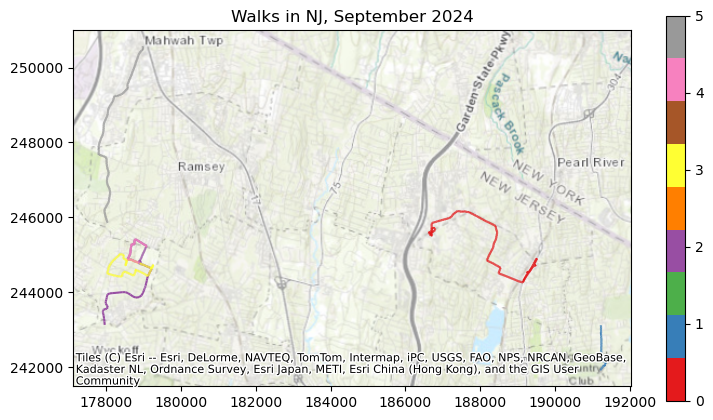

In [55]:
ax = traj_collection.plot(column='trajectory_id', legend=True, figsize=(9,5), cmap='Set1')
ax.set_title('Walks in NJ, September 2024')
ctx.add_basemap(ax, crs=gdf_proj.crs, source=ctx.providers.Esri.WorldTopoMap);

In [56]:
my_traj = traj_collection.trajectories[2]
print(my_traj)
print(my_traj.df.info())

Trajectory 2.0 (2024-09-07 21:20:23.975000 to 2024-09-07 22:03:42.022000) | Size: 267 | Length: 5173.1m
Bounds: (177912.1946985984, 243124.49067874879, 179216.17084672116, 245408.85808260852)
LINESTRING (178912.27991325516 244815.1747420021, 178912.27991325516 244815.1747420021, 178903.67850
<class 'geopandas.geodataframe.GeoDataFrame'>
DatetimeIndex: 267 entries, 2024-09-07 21:20:23.975000 to 2024-09-07 22:03:42.022000
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             267 non-null    object  
 1   Name           267 non-null    object  
 2   Lat            267 non-null    float64 
 3   Lon            267 non-null    float64 
 4   Elev           267 non-null    int64   
 5   Temp           267 non-null    float64 
 6   Weather        267 non-null    int64   
 7   geometry       267 non-null    geometry
 8   trajectory_id  267 non-null    float64 
dtypes: float64(4), geometry(1), int64(2), object

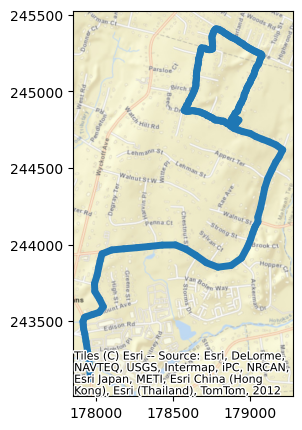

In [57]:
ax = my_traj.plot(linewidth=5, capstyle='round', figsize=(9,5))
ctx.add_basemap(ax, crs=gdf_proj.crs, source=ctx.providers.Esri.WorldStreetMap);

In [58]:
my_traj.hvplot(line_width=7.0, tiles='OSM')

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Path.I   :Path   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (triangle_angle)

In [59]:
my_traj.explore(tiles='CartoDB positron', syle_kwds={'weight':4})

# Speed

In [60]:
gdf2 = gdf_proj.loc[gdf_proj.Name == 'New York']
traj_collection2 = mpd.TrajectoryCollection(gdf2, 
                                          'trajectory_id', 
                                          t='Time', x='Lon', y='Lat')
print(traj_collection2)

TrajectoryCollection with 1 trajectories


In [61]:
traj_collection2.trajectories[0].df

,Id,Name,Lat,Lon,Elev,Temp,Weather,geometry,trajectory_id
Time,,,,,,,,,
2024-09-11 17:43:42.890,Workout-2024-09-11-17-43-42,New York,40.752025,-73.991157,91,22.46,1,POINT (192967.436 213136.871),6.0
2024-09-11 17:43:43.091,Workout-2024-09-11-17-43-42,New York,40.752025,-73.991157,91,22.46,1,POINT (192967.436 213136.871),6.0
2024-09-11 17:43:51.108,Workout-2024-09-11-17-43-42,New York,40.752071,-73.991271,78,22.46,1,POINT (192957.78 213141.923),6.0
2024-09-11 17:44:00.090,Workout-2024-09-11-17-43-42,New York,40.752118,-73.991378,63,22.46,1,POINT (192948.715 213147.089),6.0
2024-09-11 17:44:12.103,Workout-2024-09-11-17-43-42,New York,40.752164,-73.991489,43,22.46,1,POINT (192939.312 213152.143),6.0
...,...,...,...,...,...,...,...,...,...
2024-09-11 20:34:03.089,Workout-2024-09-11-17-43-42,New York,40.727142,-73.988772,0,22.46,1,POINT (193184.92 210375.072),6.0
2024-09-11 20:34:12.103,Workout-2024-09-11-17-43-42,New York,40.727053,-73.988839,0,22.46,1,POINT (193179.317 210365.156),6.0
2024-09-11 20:34:19.174,Workout-2024-09-11-17-43-42,New York,40.726973,-73.988897,0,22.46,1,POINT (193174.47 210356.245),6.0


In [62]:
my_traj2 = traj_collection2.trajectories[0]

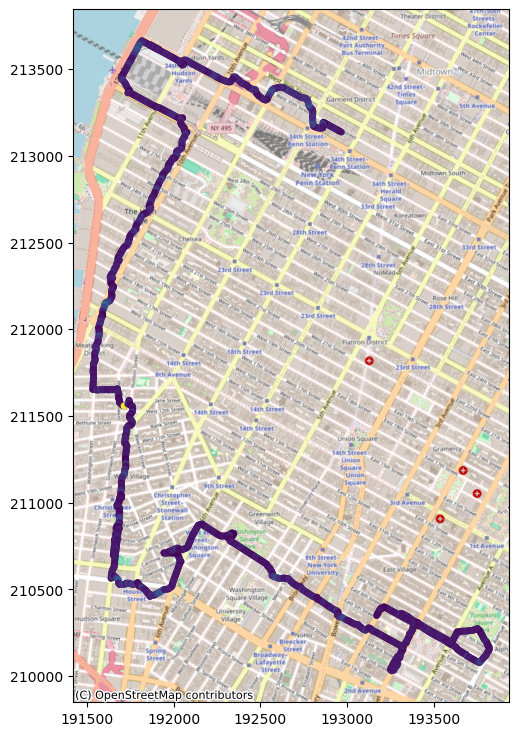

In [63]:
ax = my_traj2.plot(
    column='speed', linewidth=5, capstyle='round', figsize=(9,9)
)
ctx.add_basemap(ax, crs=gdf2.crs, source=ctx.providers.OpenStreetMap.Mapnik);

In [64]:
my_traj2.hvplot(
    c='speed', 
    clim=(0,10), 
    line_width=7.0, 
    tiles='OSM', 
    cmap='Viridis',
    height=1000, 
    width=800,
    colorbar=True
)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Path.I   :Path   [Longitude,Latitude]   (speed)
   .Points.I :Points   [Longitude,Latitude]   (speed,triangle_angle)

In [65]:
my_traj2.df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
DatetimeIndex: 981 entries, 2024-09-11 17:43:42.890000 to 2024-09-11 20:49:09.775000
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   Id             981 non-null    object  
 1   Name           981 non-null    object  
 2   Lat            981 non-null    float64 
 3   Lon            981 non-null    float64 
 4   Elev           981 non-null    int64   
 5   Temp           981 non-null    float64 
 6   Weather        981 non-null    int64   
 7   geometry       981 non-null    geometry
 8   trajectory_id  981 non-null    float64 
dtypes: float64(4), geometry(1), int64(2), object(2)
memory usage: 108.9+ KB


In [66]:
my_traj2.add_speed(overwrite=True, name='mi/h', units=('mi', 'h'))
my_traj2.df.iloc[10]

Id                                Workout-2024-09-11-17-43-42
Name                                                 New York
Lat                                                 40.752442
Lon                                                -73.992148
Elev                                                        4
Temp                                                    22.46
Weather                                                     1
geometry         POINT (192883.4866889095 213182.68923321774)
trajectory_id                                             6.0
mi/h                                                 3.368706
Name: 2024-09-11 17:44:50.083000, dtype: object

In [67]:
my_traj2.add_distance(overwrite=True, name="distance (km)", units="km")
my_traj2.add_distance(overwrite=True, name="distance (mi)", units="mi")
my_traj2.add_distance(overwrite=True, name="distance (meters)", units="m")
my_traj2.add_distance(overwrite=True, name="distance (feet)", units="ft")
my_traj2.add_timedelta(overwrite=True)
my_traj2.add_speed(overwrite=True, name="speed (ft/min)", units=("ft", "min"))
my_traj2.add_speed(overwrite=True, name="speed (km/hour)", units=("km", "h"))
my_traj2.add_speed(overwrite=True, name="speed (mi/hour)", units=("mi", "h"))
my_traj2.add_acceleration(
    overwrite=True, name="acceleration (mph/s)", units=("mi", "h", "s")
)
my_traj2.add_acceleration(
    overwrite=True, name="acceleration (kmph/s)", units=("km", "h", "s")
)
my_traj2.add_direction(overwrite=True)
my_traj2.add_angular_difference(overwrite=True)
my_traj2.df.iloc[10:20]

,Id,Name,Lat,Lon,Elev,Temp,Weather,geometry,trajectory_id,mi/h,...,distance (meters),distance (feet),timedelta,speed (ft/min),speed (km/hour),speed (mi/hour),acceleration (mph/s),acceleration (kmph/s),direction,angular_difference
Time,,,,,,,,,,,,,,,,,,,,,
2024-09-11 17:44:50.083,Workout-2024-09-11-17-43-42,New York,40.752442,-73.992148,4,22.46,1,POINT (192883.487 213182.689),6.0,3.368706,...,10.526564,34.535972,0 days 00:00:06.990000,296.446109,5.421406,3.368706,-0.078212,-0.125870,298.696353,0.000088
2024-09-11 17:44:55.092,Workout-2024-09-11-17-43-42,New York,40.752488,-73.992257,4,22.46,1,POINT (192874.253 213187.744),6.0,4.700986,...,10.526559,34.535953,0 days 00:00:05.009000,413.686802,7.565504,4.700986,0.265977,0.428049,298.696440,0.000088
2024-09-11 17:45:20.082,Workout-2024-09-11-17-43-42,New York,40.752537,-73.992375,5,22.46,1,POINT (192864.258 213193.127),6.0,1.016242,...,11.352976,37.247298,0 days 00:00:24.990000,89.429286,1.635483,1.016242,-0.147449,-0.237296,298.305428,0.391013
2024-09-11 17:45:47.085,Workout-2024-09-11-17-43-42,New York,40.752481,-73.992413,0,22.46,1,POINT (192861.085 213186.89),6.0,0.579665,...,6.997385,22.957298,0 days 00:00:27.003000,51.010551,0.932881,0.579665,-0.016168,-0.026019,206.963754,91.341674
2024-09-11 17:45:51.087,Workout-2024-09-11-17-43-42,New York,40.752347,-73.992389,-2,22.46,1,POINT (192863.197 213172.023),6.0,8.393717,...,15.016813,49.267760,0 days 00:00:04.002000,738.647072,13.508378,8.393717,1.952537,3.142303,171.912503,35.051251
2024-09-11 17:45:56.082,Workout-2024-09-11-17-43-42,New York,40.752253,-73.992423,-3,22.46,1,POINT (192860.387 213161.569),6.0,4.848026,...,10.825472,35.516639,0 days 00:00:04.995000,426.626296,7.802142,4.848026,-0.709848,-1.142390,195.048256,23.135753
2024-09-11 17:46:07.095,Workout-2024-09-11-17-43-42,New York,40.752231,-73.992549,-5,22.46,1,POINT (192849.761 213159.064),6.0,2.217365,...,10.916648,35.815774,0 days 00:00:11.013000,195.128162,3.568504,2.217365,-0.238869,-0.384422,256.737740,61.689485
2024-09-11 17:46:13.087,Workout-2024-09-11-17-43-42,New York,40.752238,-73.992672,-6,22.46,1,POINT (192839.37 213159.781),6.0,3.888328,...,10.415523,34.171662,0 days 00:00:05.992000,342.172854,6.257657,3.888328,0.278866,0.448791,273.948592,17.210852
2024-09-11 17:46:21.077,Workout-2024-09-11-17-43-42,New York,40.752258,-73.992808,-9,22.46,1,POINT (192827.874 213161.936),6.0,3.274772,...,11.696993,38.375960,0 days 00:00:07.990000,288.179926,5.270234,3.274772,-0.076790,-0.123582,280.613572,6.664980


In [68]:
print(my_traj2.df.reset_index().loc[10:12, 'trajectory_id':'angular_difference'])

    trajectory_id      mi/h  distance (km)  distance (mi)  distance (meters)  \
10            6.0  3.368706       0.010527       0.006541          10.526564   
11            6.0  4.700986       0.010527       0.006541          10.526559   
12            6.0  1.016242       0.011353       0.007054          11.352976   

    distance (feet)              timedelta  speed (ft/min)  speed (km/hour)  \
10        34.535972 0 days 00:00:06.990000      296.446109         5.421406   
11        34.535953 0 days 00:00:05.009000      413.686802         7.565504   
12        37.247298 0 days 00:00:24.990000       89.429286         1.635483   

    speed (mi/hour)  acceleration (mph/s)  acceleration (kmph/s)   direction  \
10         3.368706             -0.078212              -0.125870  298.696353   
11         4.700986              0.265977               0.428049  298.696440   
12         1.016242             -0.147449              -0.237296  298.305428   

    angular_difference  
10            0.

In [69]:
print(my_traj2.df.iloc[10::300, 9:])

                             mi/h  distance (km)  distance (mi)  \
Time                                                              
2024-09-11 17:44:50.083  3.368706       0.010527       0.006541   
2024-09-11 18:29:55.080  3.201323       0.011446       0.007112   
2024-09-11 19:27:51.055  2.737397       0.010957       0.006809   
2024-09-11 20:18:22.092  3.209047       0.010025       0.006229   

                         distance (meters)  distance (feet)  \
Time                                                          
2024-09-11 17:44:50.083          10.526564        34.535972   
2024-09-11 18:29:55.080          11.446093        37.552798   
2024-09-11 19:27:51.055          10.957242        35.948957   
2024-09-11 20:18:22.092          10.024793        32.889741   

                                     timedelta  speed (ft/min)  \
Time                                                             
2024-09-11 17:44:50.083 0 days 00:00:06.990000      296.446109   
2024-09-11 18:29:55.

In [70]:
print(f'''
    Total Distance: 
        {my_traj2.df['distance (meters)']
            .sum().item()/1000:>4.1f} kilometers
        {my_traj2.df['distance (mi)']
            .sum().item():>4.1f} miles
    Average Speed:
        {my_traj2.df['speed (km/hour)']
            .mean().item():>4.1f} kilometers per hour
        {my_traj2.df['speed (mi/hour)']
            .mean().item():>4.1f} miles per hour
''')



    Total Distance: 
        10.8 kilometers
         6.7 miles
    Average Speed:
         6.1 kilometers per hour
         3.8 miles per hour



In [71]:
my_traj2.df.columns

Index(['Id', 'Name', 'Lat', 'Lon', 'Elev', 'Temp', 'Weather', 'geometry',
       'trajectory_id', 'mi/h', 'distance (km)', 'distance (mi)',
       'distance (meters)', 'distance (feet)', 'timedelta', 'speed (ft/min)',
       'speed (km/hour)', 'speed (mi/hour)', 'acceleration (mph/s)',
       'acceleration (kmph/s)', 'direction', 'angular_difference'],
      dtype='object')

In [72]:
from shapely.geometry import LineString
line = LineString(my_traj2.df.geometry)
line.length

10763.271468744677

In [73]:
my_traj2.df.sample(10)

,Id,Name,Lat,Lon,Elev,Temp,Weather,geometry,trajectory_id,mi/h,...,distance (meters),distance (feet),timedelta,speed (ft/min),speed (km/hour),speed (mi/hour),acceleration (mph/s),acceleration (kmph/s),direction,angular_difference
Time,,,,,,,,,,,,,,,,,,,,,
2024-09-11 17:49:48.102,Workout-2024-09-11-17-43-42,New York,40.753864,-73.996660,-48,22.46,1,POINT (192501.582 213338.391),6.0,4.345418,...,11.630202,38.156829,0 days 00:00:05.987000,382.396818,6.993273,4.345418,0.061345,0.098726,308.030901,2.796503
2024-09-11 18:30:10.070,Workout-2024-09-11-17-43-42,New York,40.745169,-74.006562,-11,22.46,1,POINT (191670.891 212368.163),6.0,3.102475,...,11.069092,36.315920,0 days 00:00:07.981000,273.017819,4.992950,3.102475,-0.034954,-0.056253,190.228773,16.471401
2024-09-11 19:02:27.077,Workout-2024-09-11-17-43-42,New York,40.731559,-74.006642,13,22.46,1,POINT (191672.627 210856.893),6.0,4.262816,...,11.416746,37.456515,0 days 00:00:05.991000,375.127842,6.860338,4.262816,-0.124125,-0.199760,6.903754,0.286129
2024-09-11 19:32:11.086,Workout-2024-09-11-17-43-42,New York,40.731546,-74.000521,-12,22.46,1,POINT (192189.662 210858.372),6.0,1.957203,...,10.523001,34.524281,0 days 00:00:12.027000,172.233880,3.149813,1.957203,-0.024518,-0.039459,122.232480,0.228810
2024-09-11 18:58:42.097,Workout-2024-09-11-17-43-42,New York,40.730287,-74.006831,10,22.46,1,POINT (191657.456 210715.562),6.0,5.252439,...,11.747296,38.540996,0 days 00:00:05.003000,462.214622,8.452981,5.252439,0.243158,0.391325,186.699639,0.312174
2024-09-11 20:49:09.775,Workout-2024-09-11-17-43-42,New York,40.726903,-73.988940,0,22.46,1,POINT (193170.882 210348.451),6.0,0.000000,...,0.000000,0.000000,0 days 00:14:37.673000,0.000000,0.000000,0.000000,-0.001691,-0.002722,0.000000,155.285625
2024-09-11 18:50:37.095,Workout-2024-09-11-17-43-42,New York,40.734869,-74.006009,7,22.46,1,POINT (191724.027 211224.73),6.0,1.147343,...,27.695511,90.864537,0 days 00:00:53.997000,100.966206,1.846470,1.147343,0.017601,0.028326,176.355754,51.034763
2024-09-11 18:01:22.105,Workout-2024-09-11-17-43-42,New York,40.756754,-74.004818,-22,22.46,1,POINT (191810.915 213655.375),6.0,4.652718,...,10.412234,34.160873,0 days 00:00:05.006000,409.439149,7.487823,4.652718,-0.057963,-0.093282,219.516496,79.637380
2024-09-11 19:54:59.127,Workout-2024-09-11-17-43-42,New York,40.727179,-73.991679,1,22.46,1,POINT (192939.332 210377.755),6.0,2.642156,...,11.845745,38.863994,0 days 00:00:10.029000,232.509687,4.252137,2.642156,-0.120038,-0.193183,103.774565,19.208399


In [74]:
my_traj2.df.reset_index().iloc[0]

Time                                       2024-09-11 17:43:42.890000
Id                                        Workout-2024-09-11-17-43-42
Name                                                         New York
Lat                                                         40.752025
Lon                                                        -73.991157
Elev                                                               91
Temp                                                            22.46
Weather                                                             1
geometry                 POINT (192967.4364089026 213136.87078366883)
trajectory_id                                                     6.0
mi/h                                                              0.0
distance (km)                                                     0.0
distance (mi)                                                     0.0
distance (meters)                                                 0.0
distance (feet)     

# Mover's position

## Point

In [75]:
my_traj2.df.get_precision()

Time
2024-09-11 17:43:42.890    0.0
2024-09-11 17:43:43.091    0.0
2024-09-11 17:43:51.108    0.0
2024-09-11 17:44:00.090    0.0
2024-09-11 17:44:12.103    0.0
                          ... 
2024-09-11 20:34:03.089    0.0
2024-09-11 20:34:12.103    0.0
2024-09-11 20:34:19.174    0.0
2024-09-11 20:34:32.102    0.0
2024-09-11 20:49:09.775    0.0
Length: 981, dtype: float64

In [76]:
t = datetime(2024, 9, 11, 18, 15)
print(f'''
    Nearest:      {my_traj2.get_position_at(t, method='nearest')}
    Interpolated: {my_traj2.get_position_at(t, method='interpolated')}
    Previous row: {my_traj2.get_position_at(t, method='ffill')}
    Next row:     {my_traj2.get_position_at(t, method='bfill')}
''')


    Nearest:      POINT (191871.3733091731 213296.6054467852)
    Interpolated: POINT (191874.05973723385 213295.2357193365)
    Previous row: POINT (191871.3733091731 213296.6054467852)
    Next row:     POINT (191881.28163798578 213291.55349317295)



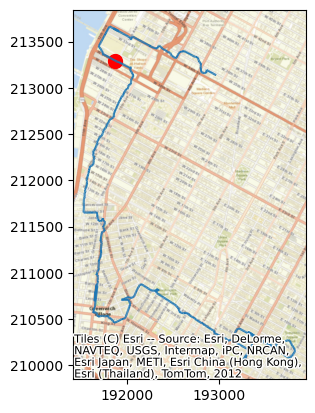

In [77]:
point = my_traj2.get_position_at(t, method='interpolated')
ax = my_traj2.plot() 
gpd.GeoSeries(point).plot(ax=ax, color='red', markersize=100)
ctx.add_basemap(ax, crs=gdf2.crs, source=ctx.providers.Esri.WorldStreetMap)

## Segment

In [78]:
t2 = t + timedelta(minutes=30)

In [79]:
segment = my_traj2.get_segment_between(t, t2)
print(segment)

Trajectory 6.0_2024-09-11 18:15:00 (2024-09-11 18:15:05.097000 to 2024-09-11 18:44:12.073000) | Size: 212 | Length: 2362.3m
Bounds: (191534.1127494892, 211557.80184185825, 192076.80390693387, 213291.55349317295)
LINESTRING (191881.28163798578 213291.55349317295, 191890.17607307943 213286.60686381863, 191899.824


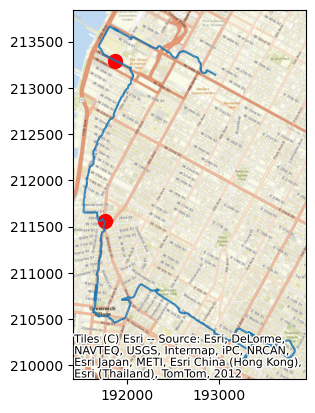

In [80]:
point2 = my_traj2.get_position_at(t2, method='interpolated')
ax = my_traj2.plot() 
gpd.GeoSeries(point).plot(ax=ax, color='red', markersize=100)
gpd.GeoSeries(point2).plot(ax=ax, color='red', markersize=100)
ctx.add_basemap(ax, crs=gdf2.crs, source=ctx.providers.Esri.WorldStreetMap)

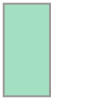

In [81]:
xmin, xmax, ymin, ymax = -74.010, -74.000, 40.735, 40.755
polygon = Polygon(
    [(xmin, ymin), (xmin, ymax), (xmax, ymax), (xmax, ymin), (xmin, ymin)]
)
polygon

In [82]:
intersections = my_traj2.clip(polygon) 
intersections

TrajectoryCollection with 0 trajectories

IndexError: list index out of range

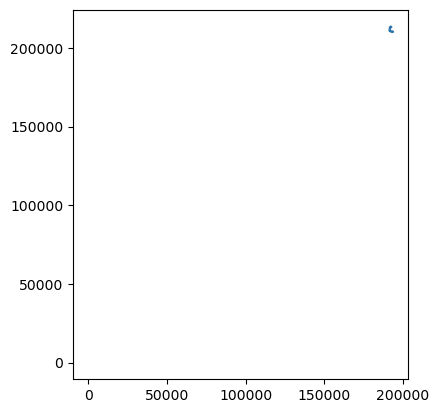

In [83]:
ax = my_traj2.plot()
gpd.GeoSeries(polygon).plot(ax=ax,
                            edgecolor='k',
                            lw=2,
                            facecolor='none'
                           )
intersections.plot(ax=ax, color='r', linewidth=5, capstyle='round')
ctx.add_basemap(ax, crs=gdf2.crs, source=ctx.providers.Esri.WorldStreetMap);

## Later show segment by stops

# Stop Detection

In [84]:
detector = mpd.TrajectoryStopDetector(my_traj2)

## Stop duration

In [85]:
%%time 
stop_time_ranges = detector.get_stop_time_ranges(
    min_duration=timedelta(seconds=120), 
    max_diameter=100
)
len(stop_time_ranges)

CPU times: user 67.1 ms, sys: 1.87 ms, total: 69 ms
Wall time: 68.7 ms


18

In [86]:
for x in stop_time_ranges: print(x)

Traj 6.0: 2024-09-11 17:44:37.079000 - 2024-09-11 17:46:44.090000 (duration: 0 days 00:02:07.011000)
Traj 6.0: 2024-09-11 17:54:47.081000 - 2024-09-11 17:56:54.066000 (duration: 0 days 00:02:06.985000)
Traj 6.0: 2024-09-11 17:58:03.096000 - 2024-09-11 18:00:46.117000 (duration: 0 days 00:02:43.021000)
Traj 6.0: 2024-09-11 18:04:21.069000 - 2024-09-11 18:14:25.100000 (duration: 0 days 00:10:04.031000)
Traj 6.0: 2024-09-11 18:16:24.098000 - 2024-09-11 18:18:26.093000 (duration: 0 days 00:02:01.995000)
Traj 6.0: 2024-09-11 18:30:52.066000 - 2024-09-11 18:33:18.120000 (duration: 0 days 00:02:26.054000)
Traj 6.0: 2024-09-11 18:43:30.096000 - 2024-09-11 18:46:11.122000 (duration: 0 days 00:02:41.026000)
Traj 6.0: 2024-09-11 18:51:54.095000 - 2024-09-11 18:54:15.062000 (duration: 0 days 00:02:20.967000)
Traj 6.0: 2024-09-11 18:54:26.082000 - 2024-09-11 18:56:43.077000 (duration: 0 days 00:02:16.995000)
Traj 6.0: 2024-09-11 18:58:01.079000 - 2024-09-11 19:01:53.091000 (duration: 0 days 00:03:5

## Stop points

In [87]:
stop_points = detector.get_stop_points(
    min_duration=timedelta(seconds=120), max_diameter=100
)
stop_points

,geometry,start_time,end_time,traj_id,duration_s
stop_id,,,,,
6.0_2024-09-11 17:44:37.079000,POINT (192860.736 213172.302),2024-09-11 17:44:37.079,2024-09-11 17:46:44.090,6.0,127.011
6.0_2024-09-11 17:54:47.081000,POINT (192056.518 213539.048),2024-09-11 17:54:47.081,2024-09-11 17:56:54.066,6.0,126.985
6.0_2024-09-11 17:58:03.096000,POINT (191887.838 213625.495),2024-09-11 17:58:03.096,2024-09-11 18:00:46.117,6.0,163.021
6.0_2024-09-11 18:04:21.069000,POINT (191775.489 213349.031),2024-09-11 18:04:21.069,2024-09-11 18:14:25.100,6.0,604.031
6.0_2024-09-11 18:16:24.098000,POINT (192029.18 213219.431),2024-09-11 18:16:24.098,2024-09-11 18:18:26.093,6.0,121.995
6.0_2024-09-11 18:30:52.066000,POINT (191642.384 212263.999),2024-09-11 18:30:52.066,2024-09-11 18:33:18.120,6.0,146.054
6.0_2024-09-11 18:43:30.096000,POINT (191747.027 211557.802),2024-09-11 18:43:30.096,2024-09-11 18:46:11.122,6.0,161.026
6.0_2024-09-11 18:51:54.095000,POINT (191697.273 211039.929),2024-09-11 18:51:54.095,2024-09-11 18:54:15.062,6.0,140.967
6.0_2024-09-11 18:54:26.082000,POINT (191686.334 210952.355),2024-09-11 18:54:26.082,2024-09-11 18:56:43.077,6.0,136.995


In [88]:
stop_point_plot = my_traj2_plot * stop_points.hvplot(
    geo=True, size='duration_s', color='blue', alpha=0.5
)
stop_point_plot

NameError: name 'my_traj2_plot' is not defined

In [39]:
stop_points_gdf = gpd.GeoDataFrame(stop_points, geometry="geometry", 
                                  crs="EPSG:4326")

In [40]:
m = my_traj2.explore(
    color='blue', 
    style_kwds=dict(weight=4),
    name='Trajectory'
)

In [41]:
stop_points_gdf.explore(
    m=m, 
    color='red', 
    style_kwds={
        "style_function": lambda x: dict(radius=x['properties']['duration_s'] / 10)
    }, 
    name='Stop points'
)

folium.TileLayer("OpenStreetMap").add_to(m)
folium.LayerControl().add_to(m)

m

## Stop Segments

In [42]:
stop_segments = detector.get_stop_segments(
    min_duration=timedelta(seconds=120), max_diameter=100
)

In [43]:
stop_segments_plot = stop_point_plot * stop_segments.hvplot(
    line_width=7.0, tiles=None, color='orange'
)
stop_segments_plot

:Overlay
   .WMTS.I       :WMTS   [Longitude,Latitude]
   .Path.I       :Path   [Longitude,Latitude]
   .Points.I     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.II    :Points   [Longitude,Latitude]   (duration_s)
   .Path.II      :Path   [Longitude,Latitude]
   .Path.III     :Path   [Longitude,Latitude]
   .Path.IV      :Path   [Longitude,Latitude]
   .Path.V       :Path   [Longitude,Latitude]
   .Path.VI      :Path   [Longitude,Latitude]
   .Path.VII     :Path   [Longitude,Latitude]
   .Path.VIII    :Path   [Longitude,Latitude]
   .Path.IX      :Path   [Longitude,Latitude]
   .Path.X       :Path   [Longitude,Latitude]
   .Path.XI      :Path   [Longitude,Latitude]
   .Path.XII     :Path   [Longitude,Latitude]
   .Path.XIII    :Path   [Longitude,Latitude]
   .Path.XIV     :Path   [Longitude,Latitude]
   .Path.XV      :Path   [Longitude,Latitude]
   .Path.XVI     :Path   [Longitude,Latitude]
   .Path.XVII    :Path   [Longitude,Latitude]
   .Path.XVIII   :Path   [Longitude,Latitude]
   .Path.XIX     :Path   [Longitude,Latitude]
   .Path.XX      :Path   [Longitude,Latitude]
   .Points.III   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IV    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.V     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VI    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VII   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.VIII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.IX    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.X     :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XI    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XII   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIV   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XV    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVI   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVII  :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XVIII :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XIX   :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XX    :Points   [Longitude,Latitude]   (triangle_angle)
   .Points.XXI   :Points   [Longitude,Latitude]   (triangle_angle)

In [44]:
m = my_traj2.explore(
    color='blue', 
    tooltip='trajectory_id', 
    popup=True, 
    style_kwds=dict(weight=4), 
    names='Trajectory'
)
stop_segments.explore(
    m=m, 
    color='orange', 
    tooltip='trajectory_id',
    popup=True, 
    style_kwds=dict(weight=4), 
    name='Stop Segments'
)
stop_points_gdf.explore(
    m=m, 
    color='red',
    tooltip='stop_id', 
    popup=True, 
    marker_kwds=dict(radius=3), 
    name='Stop points'
)
folium.TileLayer('CartoDB positron').add_to(m)
folium.LayerControl().add_to(m)

m

## Split at stops

In [45]:
split = mpd.StopSplitter(my_traj2).split(
    min_duration=timedelta(seconds=120), max_diameter=100
)
split

TrajectoryCollection with 19 trajectories

In [46]:
split.to_traj_gdf()

,trajectory_id,start_t,end_t,geometry,length,direction
0,6.0_2024-09-11 17:43:42.890000,2024-09-11 17:43:42.890,2024-09-11 17:44:37.079,"LINESTRING (-73.99116 40.75202, -73.99116 40.7...",74.595862,299.030822
1,6.0_2024-09-11 17:46:44.090000,2024-09-11 17:46:44.090,2024-09-11 17:54:47.081,"LINESTRING (-73.99308 40.75243, -73.9931 40.75...",975.067913,297.051664
2,6.0_2024-09-11 17:56:54.066000,2024-09-11 17:56:54.066,2024-09-11 17:58:03.096,"LINESTRING (-74.00224 40.75578, -74.00236 40.7...",106.524357,299.045687
3,6.0_2024-09-11 18:00:46.117000,2024-09-11 18:00:46.117,2024-09-11 18:04:21.069,"LINESTRING (-74.00428 40.75664, -74.0044 40.75...",379.969413,202.330513
4,6.0_2024-09-11 18:14:16.090000,2024-09-11 18:14:16.090,2024-09-11 18:16:24.098,"LINESTRING (-74.0048 40.7538, -74.00467 40.753...",170.144621,116.951010
5,6.0_2024-09-11 18:18:32.095000,2024-09-11 18:18:32.095,2024-09-11 18:30:52.066,"LINESTRING (-74.0021 40.7525, -74.00204 40.752...",1074.836602,205.079194
6,6.0_2024-09-11 18:33:18.120000,2024-09-11 18:33:18.120,2024-09-11 18:43:30.096,"LINESTRING (-74.00691 40.74371, -74.00688 40.7...",840.046678,174.858437
7,6.0_2024-09-11 18:46:04.071000,2024-09-11 18:46:04.071,2024-09-11 18:51:54.095,"LINESTRING (-74.00572 40.7374, -74.00573 40.73...",439.666343,187.005297
8,6.0_2024-09-11 18:54:15.062000,2024-09-11 18:54:15.062,2024-09-11 18:54:26.082,"LINESTRING (-74.00648 40.73289, -74.00649 40.7...",2.947197,191.530810
9,6.0_2024-09-11 18:56:43.077000,2024-09-11 18:56:43.077,2024-09-11 18:58:01.079,"LINESTRING (-74.00644 40.73209, -74.00648 40.7...",142.192969,190.338093


In [47]:
split.explore(
    column="trajectory_id", tiles="CartoDB dark_matter", style_kwds={"weight": 4}
)

In [48]:
stop_segments_plot + split.hvplot(
    title="Trajectory {} split at stops".format(my_traj2.id),
    line_width=7.0,
    tiles="CartoLight",
)

:Layout
   .Overlay.I  :Overlay
      .WMTS.I       :WMTS   [Longitude,Latitude]
      .Path.I       :Path   [Longitude,Latitude]
      .Points.I     :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.II    :Points   [Longitude,Latitude]   (duration_s)
      .Path.II      :Path   [Longitude,Latitude]
      .Path.III     :Path   [Longitude,Latitude]
      .Path.IV      :Path   [Longitude,Latitude]
      .Path.V       :Path   [Longitude,Latitude]
      .Path.VI      :Path   [Longitude,Latitude]
      .Path.VII     :Path   [Longitude,Latitude]
      .Path.VIII    :Path   [Longitude,Latitude]
      .Path.IX      :Path   [Longitude,Latitude]
      .Path.X       :Path   [Longitude,Latitude]
      .Path.XI      :Path   [Longitude,Latitude]
      .Path.XII     :Path   [Longitude,Latitude]
      .Path.XIII    :Path   [Longitude,Latitude]
      .Path.XIV     :Path   [Longitude,Latitude]
      .Path.XV      :Path   [Longitude,Latitude]
      .Path.XVI     :Path   [Longitude,Latitude]
      .Path.XVII    :Path   [Longitude,Latitude]
      .Path.XVIII   :Path   [Longitude,Latitude]
      .Path.XIX     :Path   [Longitude,Latitude]
      .Path.XX      :Path   [Longitude,Latitude]
      .Points.III   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.IV    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.V     :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.VI    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.VII   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.VIII  :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.IX    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.X     :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XI    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XII   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XIII  :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XIV   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XV    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XVI   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XVII  :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XVIII :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XIX   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XX    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.XXI   :Points   [Longitude,Latitude]   (triangle_angle)
   .Overlay.II :Overlay
      .WMTS.I       :WMTS   [Longitude,Latitude]
      .Path.I       :Path   [Longitude,Latitude]
      .Path.II      :Path   [Longitude,Latitude]
      .Path.III     :Path   [Longitude,Latitude]
      .Path.IV      :Path   [Longitude,Latitude]
      .Path.V       :Path   [Longitude,Latitude]
      .Path.VI      :Path   [Longitude,Latitude]
      .Path.VII     :Path   [Longitude,Latitude]
      .Path.VIII    :Path   [Longitude,Latitude]
      .Path.IX      :Path   [Longitude,Latitude]
      .Path.X       :Path   [Longitude,Latitude]
      .Path.XI      :Path   [Longitude,Latitude]
      .Path.XII     :Path   [Longitude,Latitude]
      .Path.XIII    :Path   [Longitude,Latitude]
      .Path.XIV     :Path   [Longitude,Latitude]
      .Path.XV      :Path   [Longitude,Latitude]
      .Path.XVI     :Path   [Longitude,Latitude]
      .Path.XVII    :Path   [Longitude,Latitude]
      .Path.XVIII   :Path   [Longitude,Latitude]
      .Path.XIX     :Path   [Longitude,Latitude]
      .Points.I     :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.II    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.III   :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.IV    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.V     :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.VI    :Points   [Longitude,Latitude]   (triangle_angle)
      .Points.VII   :Points   [Longitude,Latitude

In [63]:
from geopandas.tools import geocode
addresses = [{
                'id': 1,
                'name': "The Strand", 
                'addr': "828 Broadway, New York, NY 10003"
            }, 
            {
                'id': 2,
                'name': "Barnes and Noble", 
                'addr': "33 East 17th Street, 10003, New York"
            }]
add_df = pd.DataFrame(addresses)
add_df.head()

,id,name,addr
0,1,The Strand,"828 Broadway, New York, NY 10003"
1,2,Barnes and Noble,"33 East 17th Street, 10003, New York"


In [61]:
geo = geocode(
    add_df['address'], 
    provider='nominatim', user_agent='biscotty', 
    timeout=10
)
geo.head()

,geometry,address
0,POINT (-73.99094 40.73328),"Strand Bookstore, 828, Broadway, University Vi..."
1,POINT (-73.9896 40.73693),"Barnes & Noble, 33, East 17th Street, Union Sq..."


In [64]:
join = geo.join(add_df)
join.head()

,geometry,address,id,name,addr
0,POINT (-73.99094 40.73328),"Strand Bookstore, 828, Broadway, University Vi...",1,The Strand,"828 Broadway, New York, NY 10003"
1,POINT (-73.9896 40.73693),"Barnes & Noble, 33, East 17th Street, Union Sq...",2,Barnes and Noble,"33 East 17th Street, 10003, New York"


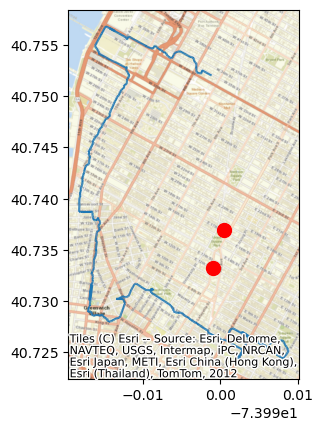

In [66]:
ax = my_traj2.plot() 
join.plot(ax=ax, color='red', markersize=100)
ctx.add_basemap(ax, crs=gdf2.crs, source=ctx.providers.Esri.WorldStreetMap)

In [103]:
join_proj = join.copy().to_crs(32111)
join_proj.crs

<Projected CRS: EPSG:32111>
Name: NAD83 / New Jersey
Axis Info [cartesian]:
- X[east]: Easting (metre)
- Y[north]: Northing (metre)
Area of Use:
- name: United States (USA) - New Jersey - counties of Atlantic; Bergen; Burlington; Camden; Cape May; Cumberland; Essex; Gloucester; Hudson; Hunterdon; Mercer; Middlesex; Monmouth; Morris; Ocean; Passaic; Salem; Somerset; Sussex; Union; Warren.
- bounds: (-75.6, 38.87, -73.88, 41.36)
Coordinate Operation:
- name: SPCS83 New Jersey zone (meter)
- method: Transverse Mercator
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [104]:
strand = join_proj.loc[0, ['geometry']]
bnn = join_proj.loc[1, ['geometry']]

In [105]:
my_traj2.distance(strand), my_traj2.distance(bnn)

(geometry    597.146942
 Name: 0, dtype: float64,
 geometry    994.112031
 Name: 1, dtype: float64)

## Stop detection for collections

In [55]:
detector = mpd.TrajectoryStopDetector(traj_collection)
stop_points = detector.get_stop_points(
    min_duration=timedelta(seconds=90), max_diameter=15
)
len(stop_points)

36

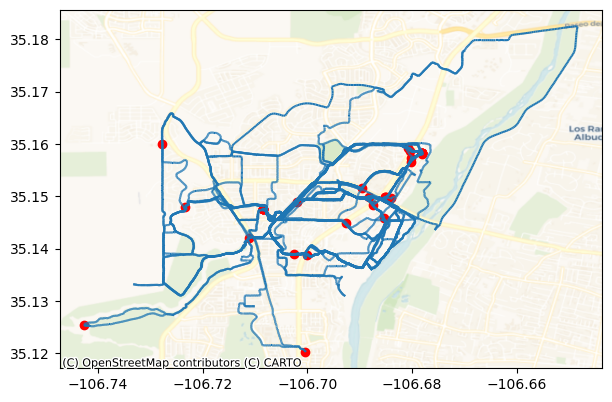

In [56]:
ax = traj_collection.plot(figsize=(7,7))
stop_points.plot(ax=ax, color='r')
ctx.add_basemap(ax, crs=gdf.crs, source=ctx.providers.CartoDB.Voyager);

In [57]:
m = traj_collection.explore(
    column="trajectory_id",
    tooltip="trajectory_id",
    popup=True,
    style_kwds={"weight": 4},
    name="Trajectories",
)

stop_points.explore(
    m=m,
    color="red",
    tooltip="stop_id",
    popup=True,
    marker_kwds={"radius": 5},
    name="Stop points",
)

folium.TileLayer("CartoDB positron").add_to(m)
folium.LayerControl().add_to(m)

m